# CS457 Assignment 2 - Question 1

In [2]:
### Student Name: Syed Hammad Ali   
### Student ID: sa04324 
### Student Email: sa04324@st.habib.edu.pk

## Retail Data :

 You are given a typical Order processing dataset of a retail company. You need to use python data science libraries to look into the dataset to gain insight of data and identify interesting trends/patterns.

## Import Libraries

In [3]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import math as math
import seaborn as sns

## Loading data from CSV

Load data from the given CSV file.

In [4]:
data = pd.read_csv('Retail.csv')

************************************************************************************************************
## Know your data

Let's chech some sample records to have a feel of data you are going to work with

In [5]:
data.head(10)

,OrderNumber,ProductName,Color,Category,Subcategory,ListPrice,Orderdate,Duedate,Shipdate,PromotionName,SalesRegion,OrderQuantity,UnitPrice,SalesAmount,DiscountAmount,TaxAmount,Freight
0,SO43843,"Mountain-100 Silver, 48",Silver,Bikes,Mountain Bikes,3399.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,2039.9940,4079.9880,0.0,326.3990,101.9997
1,SO43843,"Mountain-100 Black, 48",Black,Bikes,Mountain Bikes,3374.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,2024.9940,4049.9880,0.0,323.9990,101.2497
2,SO43843,"HL Mountain Frame - Silver, 46",Silver,Components,Mountain Frames,1204.3248,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,722.5949,1445.1898,0.0,115.6152,36.1297
3,SO43843,"Mountain-100 Black, 44",Black,Bikes,Mountain Bikes,NaN,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,5,2024.9940,10124.9700,0.0,809.9976,253.1243
4,SO43843,"HL Mountain Frame - Silver, 38",Silver,Components,Mountain Frames,1204.3248,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,722.5949,1445.1898,0.0,115.6152,36.1297
5,SO43843,"HL Mountain Frame - Silver, 48",Silver,Components,Mountain Frames,1364.5000,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,1,818.7000,818.7000,0.0,65.4960,20.4675
6,SO43843,"HL Mountain Frame - Black, 48",Black,Components,Mountain Frames,1349.6000,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,Nan,809.7600,809.7600,0.0,64.7808,20.2440
7,SO43843,"Mountain-100 Silver, 38",Silver,Bikes,Mountain Bikes,3399.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,2039.9940,4079.9880,0.0,326.3990,101.9997
8,SO43843,"Mountain Bike Socks, M",White,Clothing,Socks,9.5000,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,5.7000,11.4000,0.0,0.9120,0.2850
9,SO43843,"Mountain-100 Black, 42",Black,Bikes,Mountain Bikes,3374.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,3,2024.9940,6074.9820,0.0,485.9986,151.8746


Check the number of rows and columns that your dataset has:

data.shape

In [6]:
Check datatype of each attribute

SyntaxError: invalid syntax (<ipython-input-6-178496e2aea7>, line 1)

In [11]:
data.dtypes

OrderNumber        object
ProductName        object
Color              object
Category           object
Subcategory        object
ListPrice         float64
Orderdate          object
Duedate            object
Shipdate           object
PromotionName      object
SalesRegion        object
OrderQuantity      object
UnitPrice         float64
SalesAmount       float64
DiscountAmount    float64
TaxAmount         float64
Freight           float64
dtype: object

In [ ]:
Set the data types correctly...

In [21]:
data['ListPrice'].astype(float)
data["Orderdate"]= pd.to_datetime(data["Orderdate"])
data["Duedate"]= pd.to_datetime(data["Duedate"])
data["Shipdate"]= pd.to_datetime(data["Shipdate"])
data['UnitPrice'].astype(float)
data['SalesAmount'].astype(float)
data['DiscountAmount'].astype(float)
data['TaxAmount'].astype(float)
pd.to_numeric(data['OrderQuantity'], errors='coerce')



0        2.0
1        2.0
2        2.0
3        5.0
4        2.0
        ... 
32035    2.0
32036    1.0
32037    2.0
32038    2.0
32039    3.0
Name: OrderQuantity, Length: 32040, dtype: float64

In [20]:
data.dtypes

OrderNumber        object
ProductName        object
Color              object
Category           object
Subcategory        object
ListPrice         float64
Orderdate          object
Duedate            object
Shipdate           object
PromotionName      object
SalesRegion        object
OrderQuantity      object
UnitPrice         float64
SalesAmount       float64
DiscountAmount    float64
TaxAmount         float64
Freight           float64
dtype: object

How many distinct values does each column have?

In [13]:
data.nunique()

OrderNumber       1871
ProductName        250
Color                8
Category             4
Subcategory         33
ListPrice          103
Orderdate           17
Duedate             17
Shipdate            17
PromotionName        7
SalesRegion         10
OrderQuantity       38
UnitPrice          214
SalesAmount       1271
DiscountAmount     382
TaxAmount         1271
Freight           1266
dtype: int64

Use describe method to check basic statiscal measures of your data like count, mean, min, max, std quantiles etc

In [14]:
data.describe

<bound method NDFrame.describe of       OrderNumber                     ProductName   Color    Category  \
0         SO43843         Mountain-100 Silver, 48  Silver       Bikes   
1         SO43843          Mountain-100 Black, 48   Black       Bikes   
2         SO43843  HL Mountain Frame - Silver, 46  Silver  Components   
3         SO43843          Mountain-100 Black, 44   Black       Bikes   
4         SO43843  HL Mountain Frame - Silver, 38  Silver  Components   
...           ...                             ...     ...         ...   
32035     SO61267           Touring-1000 Blue, 60    Blue       Bikes   
32036     SO61267           Touring-2000 Blue, 60    Blue       Bikes   
32037     SO61267     HL Touring Frame - Blue, 60    Blue  Components   
32038     SO61267           Touring-2000 Blue, 54    Blue       Bikes   
32039     SO61268   LL Touring Frame - Yellow, 50  Yellow  Components   

           Subcategory  ListPrice  Orderdate    Duedate   Shipdate  \
0       Mountain Bi

# Data Cleaning

There are some error in the dataset that you need to fix:

How many null values are there in each columns?
    
    


In [15]:
data.isnull().sum()

OrderNumber          0
ProductName          0
Color             2967
Category             0
Subcategory          0
ListPrice            8
Orderdate            0
Duedate              0
Shipdate             0
PromotionName        0
SalesRegion         15
OrderQuantity       14
UnitPrice            0
SalesAmount          0
DiscountAmount       0
TaxAmount            0
Freight              0
dtype: int64

- Some of the products have Quantity as Null, you need to set their quantity to 1.

In [16]:
data['OrderQuantity'].fillna(1)

0        2
1        2
2        2
3        5
4        2
        ..
32035    2
32036    1
32037    2
32038    2
32039    3
Name: OrderQuantity, Length: 32040, dtype: object

- Some of the products have Null List Price, set their price as the mean of that product price in other orders.
    

In [7]:
data.head(10)

,OrderNumber,ProductName,Color,Category,Subcategory,ListPrice,Orderdate,Duedate,Shipdate,PromotionName,SalesRegion,OrderQuantity,UnitPrice,SalesAmount,DiscountAmount,TaxAmount,Freight
0,SO43843,"Mountain-100 Silver, 48",Silver,Bikes,Mountain Bikes,3399.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,2039.9940,4079.9880,0.0,326.3990,101.9997
1,SO43843,"Mountain-100 Black, 48",Black,Bikes,Mountain Bikes,3374.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,2024.9940,4049.9880,0.0,323.9990,101.2497
2,SO43843,"HL Mountain Frame - Silver, 46",Silver,Components,Mountain Frames,1204.3248,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,722.5949,1445.1898,0.0,115.6152,36.1297
3,SO43843,"Mountain-100 Black, 44",Black,Bikes,Mountain Bikes,NaN,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,5,2024.9940,10124.9700,0.0,809.9976,253.1243
4,SO43843,"HL Mountain Frame - Silver, 38",Silver,Components,Mountain Frames,1204.3248,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,722.5949,1445.1898,0.0,115.6152,36.1297
5,SO43843,"HL Mountain Frame - Silver, 48",Silver,Components,Mountain Frames,1364.5000,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,1,818.7000,818.7000,0.0,65.4960,20.4675
6,SO43843,"HL Mountain Frame - Black, 48",Black,Components,Mountain Frames,1349.6000,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,Nan,809.7600,809.7600,0.0,64.7808,20.2440
7,SO43843,"Mountain-100 Silver, 38",Silver,Bikes,Mountain Bikes,3399.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,2039.9940,4079.9880,0.0,326.3990,101.9997
8,SO43843,"Mountain Bike Socks, M",White,Clothing,Socks,9.5000,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,5.7000,11.4000,0.0,0.9120,0.2850
9,SO43843,"Mountain-100 Black, 42",Black,Bikes,Mountain Bikes,3374.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,3,2024.9940,6074.9820,0.0,485.9986,151.8746


In [7]:
for i in range(10):        
    if (np.isnan(data.loc[i, 'ListPrice'])):
        data.loc[i, 'ListPrice'] = data.loc[data['ProductName'] == data.iloc[i].ProductName].ListPrice.mean()

- Some orders do not have a sales region assigned, you need to remove such order lines

In [19]:
data['SalesRegion'].dropna()

0          Central
1          Central
2          Central
3          Central
4          Central
           ...    
32035    Northwest
32036    Northwest
32037    Northwest
32038    Northwest
32039    Southwest
Name: SalesRegion, Length: 32025, dtype: object

- Some orders have Due date less than Order date, due date should be set as Order data in such cases.

In [32]:
data.loc[data['Duedate'] < data['Orderdate'], 'Duedate'] = data['Orderdate']


In [12]:
data.head(10)

,OrderNumber,ProductName,Color,Category,Subcategory,ListPrice,Orderdate,Duedate,Shipdate,PromotionName,SalesRegion,OrderQuantity,UnitPrice,SalesAmount,DiscountAmount,TaxAmount,Freight
0,SO43843,"Mountain-100 Silver, 48",Silver,Bikes,Mountain Bikes,3399.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,2039.9940,4079.9880,0.0,326.3990,101.9997
1,SO43843,"Mountain-100 Black, 48",Black,Bikes,Mountain Bikes,3374.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,2024.9940,4049.9880,0.0,323.9990,101.2497
2,SO43843,"HL Mountain Frame - Silver, 46",Silver,Components,Mountain Frames,1204.3248,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,722.5949,1445.1898,0.0,115.6152,36.1297
3,SO43843,"Mountain-100 Black, 44",Black,Bikes,Mountain Bikes,NaN,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,5,2024.9940,10124.9700,0.0,809.9976,253.1243
4,SO43843,"HL Mountain Frame - Silver, 38",Silver,Components,Mountain Frames,1204.3248,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,722.5949,1445.1898,0.0,115.6152,36.1297
5,SO43843,"HL Mountain Frame - Silver, 48",Silver,Components,Mountain Frames,1364.5000,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,1,818.7000,818.7000,0.0,65.4960,20.4675
6,SO43843,"HL Mountain Frame - Black, 48",Black,Components,Mountain Frames,1349.6000,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,Nan,809.7600,809.7600,0.0,64.7808,20.2440
7,SO43843,"Mountain-100 Silver, 38",Silver,Bikes,Mountain Bikes,3399.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,2039.9940,4079.9880,0.0,326.3990,101.9997
8,SO43843,"Mountain Bike Socks, M",White,Clothing,Socks,9.5000,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,5.7000,11.4000,0.0,0.9120,0.2850
9,SO43843,"Mountain-100 Black, 42",Black,Bikes,Mountain Bikes,3374.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,3,2024.9940,6074.9820,0.0,485.9986,151.8746


Do you feel there are outliers in the data? Let's eliminate extreme values (if any) in Order Sales Amount. 
Note: Extreme values can be seen as those outside +/- 3 standard deviation. 

Do you think this is wise to identify outliers this way?


In [38]:
data = (data[np.abs(data.SalesAmount-data.SalesAmount.mean()) <= (3*data.SalesAmount.std())])


,OrderNumber,ProductName,Color,Category,Subcategory,ListPrice,Orderdate,Duedate,Shipdate,PromotionName,SalesRegion,OrderQuantity,UnitPrice,SalesAmount,DiscountAmount,TaxAmount,Freight,NormalizaedPrice
0,SO43843,"Mountain-100 Silver, 48",Silver,Bikes,Mountain Bikes,3399.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,7.620702,4079.9880,0.0,326.3990,101.9997,3.152656
1,SO43843,"Mountain-100 Black, 48",Black,Bikes,Mountain Bikes,3374.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,7.613322,4049.9880,0.0,323.9990,101.2497,3.123304
2,SO43843,"HL Mountain Frame - Silver, 46",Silver,Components,Mountain Frames,1204.3248,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,6.582849,1445.1898,0.0,115.6152,36.1297,0.574798
4,SO43843,"HL Mountain Frame - Silver, 38",Silver,Components,Mountain Frames,1204.3248,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,6.582849,1445.1898,0.0,115.6152,36.1297,0.574798
5,SO43843,"HL Mountain Frame - Silver, 48",Silver,Components,Mountain Frames,1364.5000,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,1,6.707718,818.7000,0.0,65.4960,20.4675,0.762854
6,SO43843,"HL Mountain Frame - Black, 48",Black,Components,Mountain Frames,1349.6000,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,Nan,6.696738,809.7600,0.0,64.7808,20.2440,0.745361
7,SO43843,"Mountain-100 Silver, 38",Silver,Bikes,Mountain Bikes,3399.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,7.620702,4079.9880,0.0,326.3990,101.9997,3.152656
8,SO43843,"Mountain Bike Socks, M",White,Clothing,Socks,9.5000,1/29/2011,2/10/2011,2/5/2011,No Discount,Central,2,1.740466,11.4000,0.0,0.9120,0.2850,-0.828007
11,SO43844,"Mountain-100 Black, 42",Black,Bikes,Mountain Bikes,3374.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,NaN,2,7.613322,4049.9880,0.0,323.9990,101.2497,3.123304
13,SO43844,"Mountain-100 Black, 48",Black,Bikes,Mountain Bikes,3374.9900,1/29/2011,2/10/2011,2/5/2011,No Discount,NaN,1,7.613322,2024.9940,0.0,161.9995,50.6249,3.123304


In [ ]:
#Yes, because if empirically 99.7% of data lies under +/- 3 standard deviations, the outliers(which are only 0.3% and are distinct than the rest of the 99.7% data) can be eliminated which may be causing our data some statistical damage.  

# Data Exploration

Check how many products have been sold under each category.

In [52]:
n_by_category = data.groupby("Category")["ProductName"].count()
n_by_category

10641

Draw boxplot of cateogry vs product list price to compare prices of products across categories.

<AxesSubplot:title={'center':'ListPrice'}, xlabel='Category'>

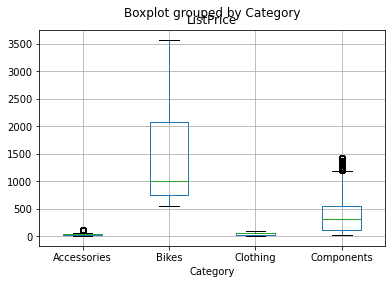

In [42]:
data.boxplot(by ='Category', column =['ListPrice'], grid = True)

Plot bar chart and pie chart to see total sales of products in each category.

<AxesSubplot:xlabel='Category'>

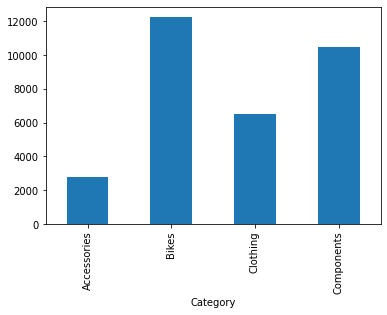

In [9]:
n_by_category = data.groupby("Category")["ProductName"].count()
n_by_category.plot.bar()


<AxesSubplot:ylabel='ProductName'>

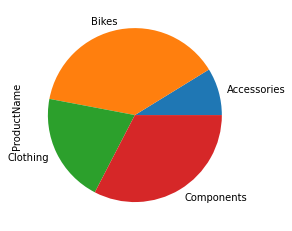

In [8]:
n_by_category.plot.pie()

In [ ]:
# Write your analysis after every question. Select Markdown from top menu instead of Code and then execute the cell

---------------------------------------------
Plot histogram of all numeric attrubites to see their distribution

array([[<AxesSubplot:title={'center':'ListPrice'}>,
        <AxesSubplot:title={'center':'UnitPrice'}>,
        <AxesSubplot:title={'center':'SalesAmount'}>],
       [<AxesSubplot:title={'center':'DiscountAmount'}>,
        <AxesSubplot:title={'center':'TaxAmount'}>,
        <AxesSubplot:title={'center':'Freight'}>],
       [<AxesSubplot:title={'center':'NormalizaedPrice'}>,
        <AxesSubplot:>, <AxesSubplot:>]], dtype=object)

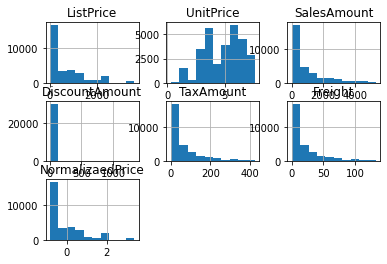

In [45]:
data.hist()
#All columns except UnitPrice are right skewed

Plor bar chart for categorial attributes Category, SubCategory, Promotion and Region.

<AxesSubplot:xlabel='Category'>

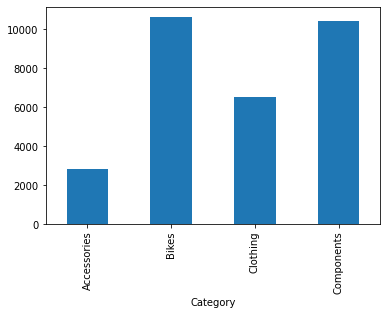

In [57]:
#Category
n_by_category = data.groupby("Category")["ProductName"].count()
n_by_category.plot.bar()


<AxesSubplot:xlabel='Subcategory'>

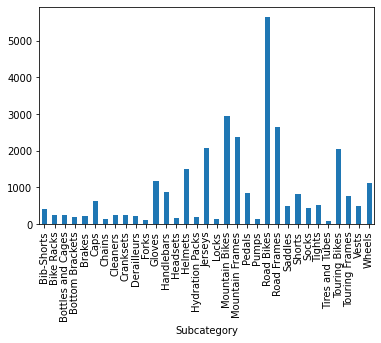

In [59]:
#subcategory
n_by_sub = data.groupby("Subcategory")["ProductName"].count()
n_by_sub.plot.bar()

<AxesSubplot:xlabel='SalesRegion'>

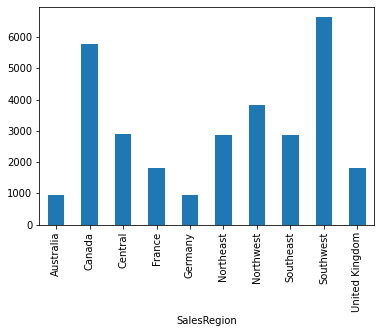

In [62]:
#Region
n_by_region = data.groupby("SalesRegion")["ProductName"].count()
n_by_region.plot.bar()

Plot bar chart for promotions. You need to exclude 'No Discount' data while plotting bar chart.

<AxesSubplot:xlabel='PromotionName'>

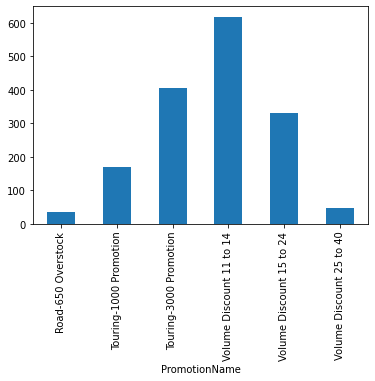

In [74]:
#Promotion

#Filter data
nopromotionData = data.loc[data['PromotionName'] != 'No Discount']
n_by_promo = data.groupby('PromotionName')['ProductName'].count()
n_by_promo.plot.bar()
#Plot bar chart


In [ ]:
# Write your analysis after every question. Select Markdown from top menu instead of Code and then execute the cell

Plot number of orders placed on each day of week. Is there any interesting trend?

In [ ]:
day_per_order ={}

for i in range(len(data)):
  if data.iloc[i,6].day_name() not in day_per_order:
    day_per_order[data.iloc[i,6].day_name()] = 1
  else:
    day_per_order [data.iloc[i,6].day_name()]+=1

lists = sorted(day_per_order.items()) 

x, y = zip(*lists) 

plt.plot(x, y)
plt.show()

#People start order more over weekdays compared to weekends.

#help taken in this

Is there any impact of promotion on overall product sales?

In [18]:
x = len(data.loc[data['PromotionName'] == 'No Discount'])
y = len(data)
print(y,x)

#There is not much difference as only 1765 products with promotions were sold as compared to 30275 products with no discount

32040 30275


Insert a new column 'ProcessingDays' which is calculated as ShippedDate - OrderDate

In [23]:
data['ProcessingDays'] = data['Shipdate'] - data['Orderdate']
data.head(10)

,OrderNumber,ProductName,Color,Category,Subcategory,ListPrice,Orderdate,Duedate,Shipdate,PromotionName,SalesRegion,OrderQuantity,UnitPrice,SalesAmount,DiscountAmount,TaxAmount,Freight,ProcessingDays
0,SO43843,"Mountain-100 Silver, 48",Silver,Bikes,Mountain Bikes,3399.9900,2011-01-29,2011-02-10,2011-02-05,No Discount,Central,2,2039.9940,4079.9880,0.0,326.3990,101.9997,7 days
1,SO43843,"Mountain-100 Black, 48",Black,Bikes,Mountain Bikes,3374.9900,2011-01-29,2011-02-10,2011-02-05,No Discount,Central,2,2024.9940,4049.9880,0.0,323.9990,101.2497,7 days
2,SO43843,"HL Mountain Frame - Silver, 46",Silver,Components,Mountain Frames,1204.3248,2011-01-29,2011-02-10,2011-02-05,No Discount,Central,2,722.5949,1445.1898,0.0,115.6152,36.1297,7 days
3,SO43843,"Mountain-100 Black, 44",Black,Bikes,Mountain Bikes,NaN,2011-01-29,2011-02-10,2011-02-05,No Discount,Central,5,2024.9940,10124.9700,0.0,809.9976,253.1243,7 days
4,SO43843,"HL Mountain Frame - Silver, 38",Silver,Components,Mountain Frames,1204.3248,2011-01-29,2011-02-10,2011-02-05,No Discount,Central,2,722.5949,1445.1898,0.0,115.6152,36.1297,7 days
5,SO43843,"HL Mountain Frame - Silver, 48",Silver,Components,Mountain Frames,1364.5000,2011-01-29,2011-02-10,2011-02-05,No Discount,Central,1,818.7000,818.7000,0.0,65.4960,20.4675,7 days
6,SO43843,"HL Mountain Frame - Black, 48",Black,Components,Mountain Frames,1349.6000,2011-01-29,2011-02-10,2011-02-05,No Discount,Central,Nan,809.7600,809.7600,0.0,64.7808,20.2440,7 days
7,SO43843,"Mountain-100 Silver, 38",Silver,Bikes,Mountain Bikes,3399.9900,2011-01-29,2011-02-10,2011-02-05,No Discount,Central,2,2039.9940,4079.9880,0.0,326.3990,101.9997,7 days
8,SO43843,"Mountain Bike Socks, M",White,Clothing,Socks,9.5000,2011-01-29,2011-02-10,2011-02-05,No Discount,Central,2,5.7000,11.4000,0.0,0.9120,0.2850,7 days
9,SO43843,"Mountain-100 Black, 42",Black,Bikes,Mountain Bikes,3374.9900,2011-01-29,2011-02-10,2011-02-05,No Discount,Central,3,2024.9940,6074.9820,0.0,485.9986,151.8746,7 days


What is the average processing time? Are there deviations from that average? Draw boxplot of ProcessingDays to analyse. 
Do you see any outlier here?

In [26]:
data["ProcessingDays"].mean()
data[np.abs(data.ProcessingDays-data.ProcessingDays.mean()) > (3*data.ProcessingDays.std())]


,OrderNumber,ProductName,Color,Category,Subcategory,ListPrice,Orderdate,Duedate,Shipdate,PromotionName,SalesRegion,OrderQuantity,UnitPrice,SalesAmount,DiscountAmount,TaxAmount,Freight,ProcessingDays


In [ ]:
#There isnt any outlier

Perform some analysis on the number of products in an order. What is their average, min, max etc. Use appropriate tools to present a summary of this information.

In [43]:
n_by_order = data.groupby("OrderNumber")["ProductName"].count()
n_by_order.to_frame()

print(n_by_order.mean())
print(n_by_order.min())
print(n_by_order.max())
n_by_order

17.124532335649384
1
72


OrderNumber
SO43843    10
SO43844     4
SO43845    10
SO43846     4
SO43847     3
           ..
SO61263    32
SO61264    20
SO61266     9
SO61267    15
SO61268     1
Name: ProductName, Length: 1871, dtype: int64

Perform some other meaningful analysis on the data and present your findings.

## Normalization

Create a new column 'NormalizedPrice' that contains normalized ListPrice of products. Z-Score normalization will be performed.

In [28]:
data['NormalizaedPrice']= (data['ListPrice'] - data['ListPrice'].mean())/data['ListPrice'].std()

Is product price following a normal distribution? Is it skewed? Plot histogram.

<AxesSubplot:>

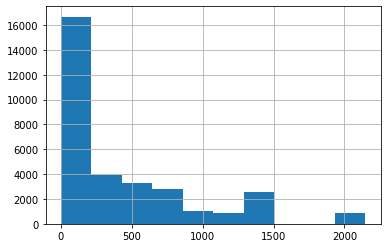

In [22]:
data['UnitPrice'].hist()

In [ ]:
#Yes the UnitPrice is right skewed.

Let's update UnitPrice by its log and then plot histogram. Is there any change?

<AxesSubplot:>

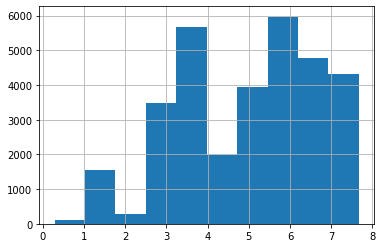

In [29]:
data['UnitPrice'] = np.log(data['UnitPrice'])
data['UnitPrice'].hist()

In [ ]:
#The graph became left skewed.

Let's investigate if prices within categories are normally distributed and present your analysis.

In [ ]:
# Write your analysis after every question. Select Markdown from top menu instead of Code and then execute the cell

Product prices are on a continuous scale. You want to descritize them. User KBinDiscretizer to find boundaries using:
- equal bin discretization 
- equal frequency discretization
- kmeans discretization

Which one do you think is better?

In [ ]:
#Equal-bin
from sklearn.preprocessing import KBinsDiscretizer as kb
enc1 = kb(n_bins = 5, encode = 'ordinal', stratergy = 'uniform')
df = pd.factorize(data['ListPrice'])[0].reshape(1, -1)
df_binned = enc1.fit_transform(df)

In [44]:
#Equal- Frequesncy
from sklearn.preprocessing import KBinsDiscretizer as kb
enc1 = kb(n_bins = 4, encode = 'ordinal')
df = pd.factorize(data['ListPrice'])[0].reshape(1, -1)
df_binned = enc1.fit_transform(df)
 

In [ ]:
#Kmeans
from sklearn.preprocessing import KBinsDiscretizer as kb
enc1 = kb(n_bins = 4, encode = 'ordinal', stratergy = 'kmeans')
df = pd.factorize(data['ListPrice'])[0].reshape(1, -1)
df_binned = enc1.fit_transform(df)

#Write your analysis after every question. Select Markdown from top menu instead of Code and then execute the cell

### Correlation:
Study correlation between attributes via:
- correlation coefficients
- scatter plot matrix
- plotting heatmap

You can focus on numeric attributes for this.

In [35]:
#correlation coefficients
df_corr = data.corr()
corr = abs(df_corr['ListPrice']).sort_values(ascending=False)


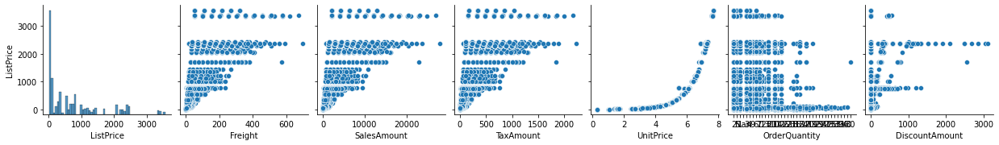

In [33]:
#Scatter plot
sns.pairplot(data, x_vars= ['ListPrice','Freight','SalesAmount','TaxAmount','UnitPrice','OrderQuantity','DiscountAmount'],y_vars = 'ListPrice')

<AxesSubplot:>

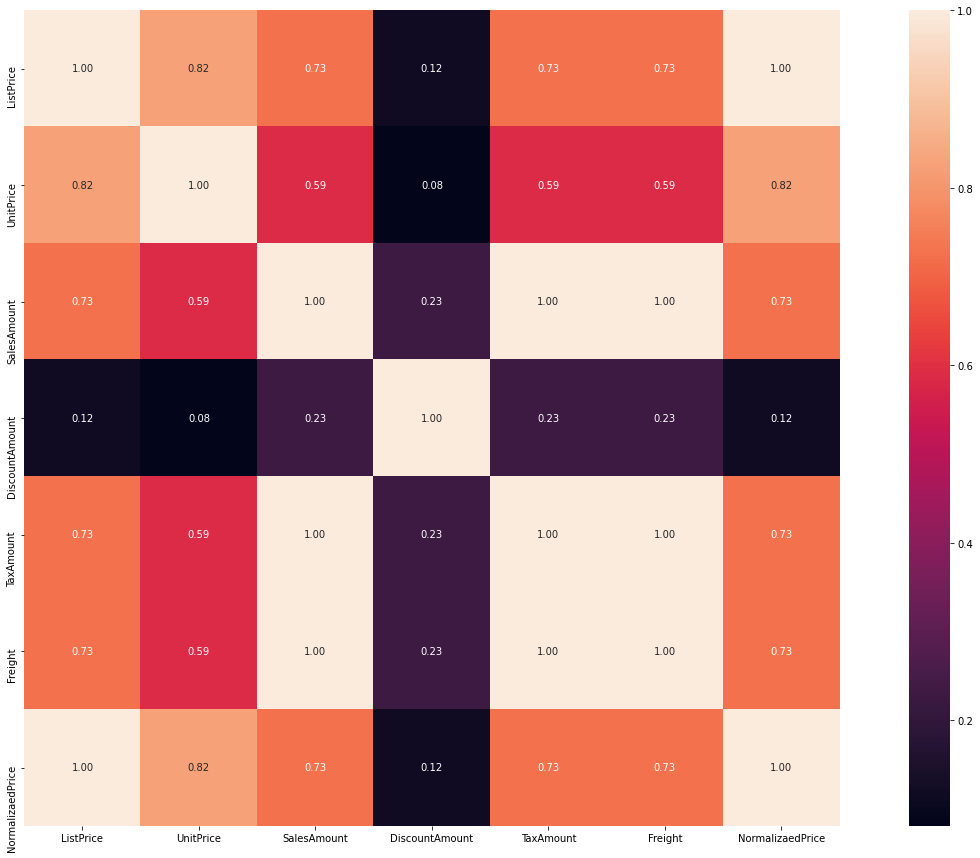

In [36]:
#Heatmap
data_corr = data.corr()
fig,ax = plt.subplots()
fig.set_size_inches(25,15)
sns.heatmap(data_corr, square = True, annot = True , fmt = '.2f')

#Write your analysis after every question. Select Markdown from top menu instead of Code and then execute the cell